### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

### Setup

In [5]:
DATA_VERSION = 'v4'

In [6]:
fig_dir = '../' + DATA_VERSION + '-fig/fig-cgis/SCCS/'

In [7]:
cgi_csv = '../data/' + DATA_VERSION + '/institutions_data_prepped.csv'

In [8]:
cgi_df = pd.read_csv(cgi_csv)

In [9]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mec

Note: CGI -> CGI *mechanisms*

In [10]:
cgi_only_df = cgi_df[cgi_df['CGI'].notna()]

In [11]:
cgi_only_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mec

In [12]:
# SCCS-only 
cgi_only_df = cgi_only_df.loc[cgi_only_df['is_SCCS'] == 1]
cgi_only_df['is_SCCS']

311    1
312    1
316    1
318    1
321    1
325    1
333    1
335    1
337    1
339    1
340    1
341    1
342    1
348    1
351    1
355    1
356    1
360    1
362    1
363    1
368    1
370    1
381    1
382    1
387    1
390    1
392    1
393    1
399    1
403    1
404    1
405    1
406    1
408    1
410    1
413    1
414    1
421    1
426    1
429    1
435    1
437    1
438    1
441    1
444    1
451    1
452    1
454    1
Name: is_SCCS, dtype: int64

In [13]:
cgi_only_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,SCCS,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mec

In [14]:
cgi_mechanisms_list = [x for x in cgi_only_df.columns if 'cgis_include_' in x]
cgi_mechanisms_list

['enforcement_cgis_include_jury_judge',
 'access_cgis_include_election',
 'enforcement_cgis_include_tribunal_court_',
 'decision_making_cgis_include_temporary_position_of_power_term_limits',
 'enforcement_cgis_include_arbitration',
 'access_cgis_include_matrilineality',
 'access_cgis_include_age_boundaries',
 'decision_making_cgis_include_magistrate_official',
 'decision_making_cgis_include_deliberation',
 'decision_making_cgis_include_consensus',
 'enforcement_cgis_include_mediation',
 'enforcement_cgis_include_graduated_sanctions',
 'enforcement_cgis_include_capital_punishment',
 'access_cgis_include_co-optation',
 'decision_making_cgis_include_consultation',
 'access_cgis_include_heredity',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'decision_making_cgis_include_consent',
 'decision_making_cgis_include_oath',
 'access_cgis_include_popularity_',
 'decision_making_cgis_include_quorum',
 'access_cgis_include_property_requirement',
 'decision_making_cgis_i

In [15]:
cgi_mechanisms_df = cgi_only_df[cgi_mechanisms_list]

In [16]:
cgi_mechanisms_df

,enforcement_cgis_include_jury_judge,access_cgis_include_election,enforcement_cgis_include_tribunal_court_,decision_making_cgis_include_temporary_position_of_power_term_limits,enforcement_cgis_include_arbitration,access_cgis_include_matrilineality,access_cgis_include_age_boundaries,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_deliberation,decision_making_cgis_include_consensus,enforcement_cgis_include_mediation,enforcement_cgis_include_graduated_sanctions,enforcement_cgis_include_capital_punishment,access_cgis_include_co-optation,decision_making_cgis_include_consultation,access_cgis_include_heredity,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_consent,decision_making_cgis_include_oath,access_cgis_include_popularity_,decision_making_cgis_include_quorum,access_cgis_include_property_requirement,decision_making_cgis_include_veto,access_cgis_include_screening_process,access_cgis_include_patronage_for_office,decision_making_cgis_include_plurality_voting,enforcement_cgis_include_criticism_mocking_joking,decision_making_cgis_include_public_meetings,enforcement_cgis_include_litigation,decision_making_cgis_include_frequent_and_or_regular_meetings,decision_making_cgis_include_remunerated_position,access_cgis_include_child_participation,enforcement_cgis_include_negotiation,decision_making_cgis_include_council_local,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_gathering,access_cgis_include_gerontocracy,decision_making_cgis_include_supermajority,enforcement_cgis_include_exit,decision_making_cgis_include_majority_voting,decision_making_cgis_include_group_voting,decision_making_cgis_include_vote_by_show_of_hands,access_cgis_include_matriarchy,decision_making_cgis_include_unanimity,decision_making_cgis_include_representation,decision_making_cgis_include_board_committee,enforcement_cgis_include_corporal_punishment_violence_against_perpetrator,access_cgis_include_payment_for_occupying_office,decision_making_cgis_include_assembly_central,access_cgis_include_lottery_random_selection,enforcement_cgis_include_appeal,decision_making_cgis_include_turnover_rotation,access_cgis_include_female_participation,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_assembly_elite,decision_making_cgis_include_delegation,decision_making_cgis_include_voting,decision_making_cgis_include_council_central_,access_cgis_include_meritocracy,enforcement_cgis_include_judicial_review,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_assembly_local,enforcement_cgis_include_reputational_risk,enforcement_cgis_include_scrutiny_of_officials,access_cgis_include_blood_relations,enforcement_cgis_include_fines,access_cgis_include_life_appointment
311,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
312,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
316,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
318,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
321,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
325,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0
333,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
335,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [17]:
cgi_mechanisms_df.sum().sort_values(ascending=False)

decision_making_cgis_include_deliberation                                    26
decision_making_cgis_include_council_central_                                20
access_cgis_include_gerontocracy                                             17
decision_making_cgis_include_council_local                                   17
decision_making_cgis_include_consensus                                       14
decision_making_cgis_include_representation                                  12
enforcement_cgis_include_tribunal_court_                                     10
decision_making_cgis_include_public_meetings                                  7
decision_making_cgis_include_gathering                                        6
access_cgis_include_female_participation                                      5
access_cgis_include_election                                                  5
access_cgis_include_meritocracy                                               5
decision_making_cgis_include_unanimity  

In [18]:
cgi_mechanisms_df.sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_histogram.png')
plt.show()

TODO: 
  - comparative analysis b/n CGI mechanisms and non-CGI mechanisms

## By Mechanism category

In [19]:
access_cgis = [x for x in cgi_df.columns if 'access_cgis_' in x]

In [20]:
cgi_df[access_cgis]

,access_cgis_include_election,access_cgis_include_matrilineality,access_cgis_include_age_boundaries,access_cgis_include_co-optation,access_cgis_include_heredity,access_cgis_include_popularity_,access_cgis_include_property_requirement,access_cgis_include_screening_process,access_cgis_include_patronage_for_office,access_cgis_include_child_participation,access_cgis_include_gerontocracy,access_cgis_include_matriarchy,access_cgis_include_payment_for_occupying_office,access_cgis_include_lottery_random_selection,access_cgis_include_female_participation,access_cgis_include_meritocracy,access_cgis_include_blood_relations,access_cgis_include_life_appointment
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<Axes: >

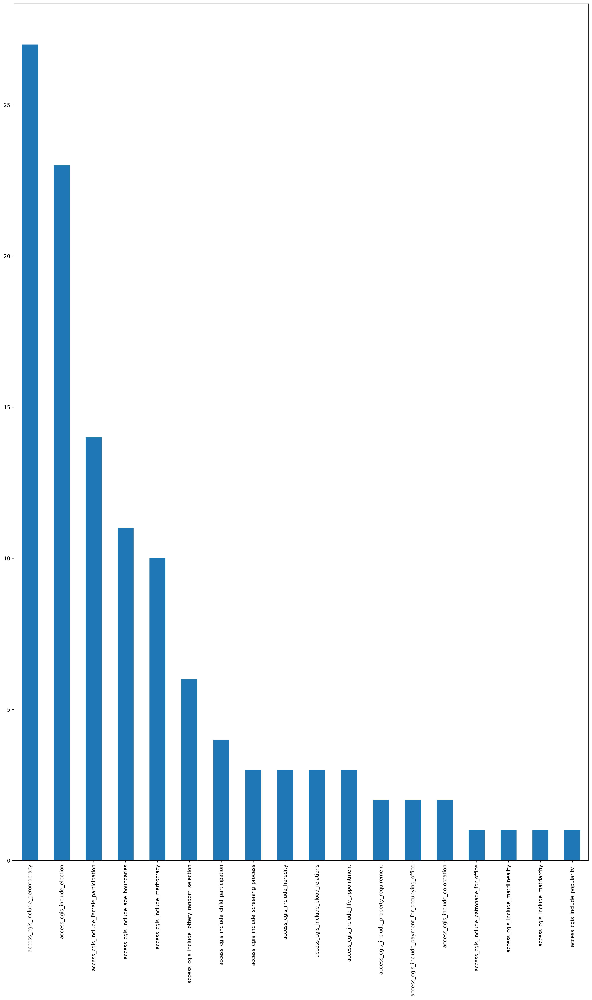

In [21]:
cgi_df[access_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

In [22]:
decision_making_cgis = [x for x in cgi_df.columns if 'decision_making_cgis_' in x]

<Axes: >

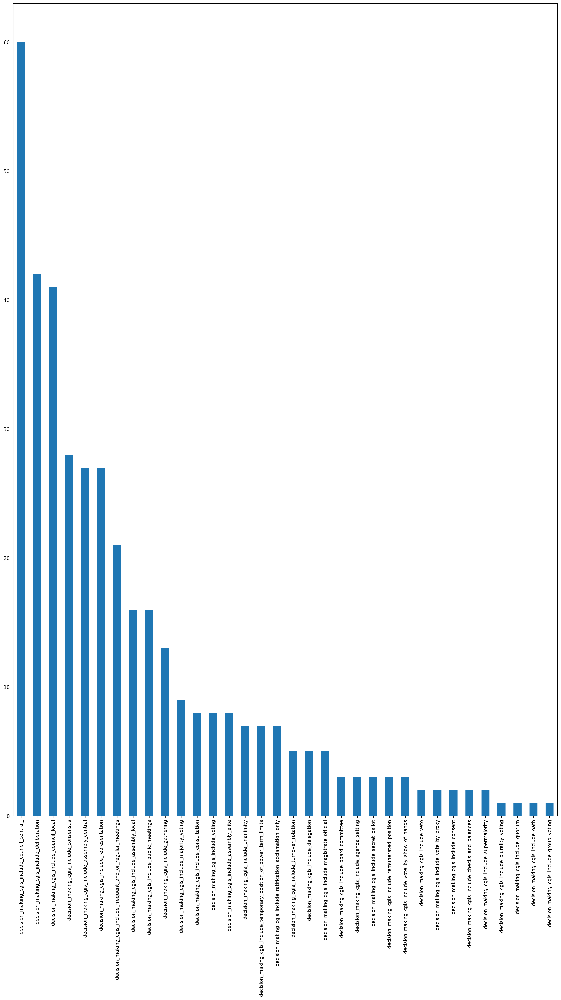

In [23]:
cgi_df[decision_making_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

In [24]:
enforcement_cgis = [x for x in cgi_df.columns if 'enforcement_cgis_' in x]

<Axes: >

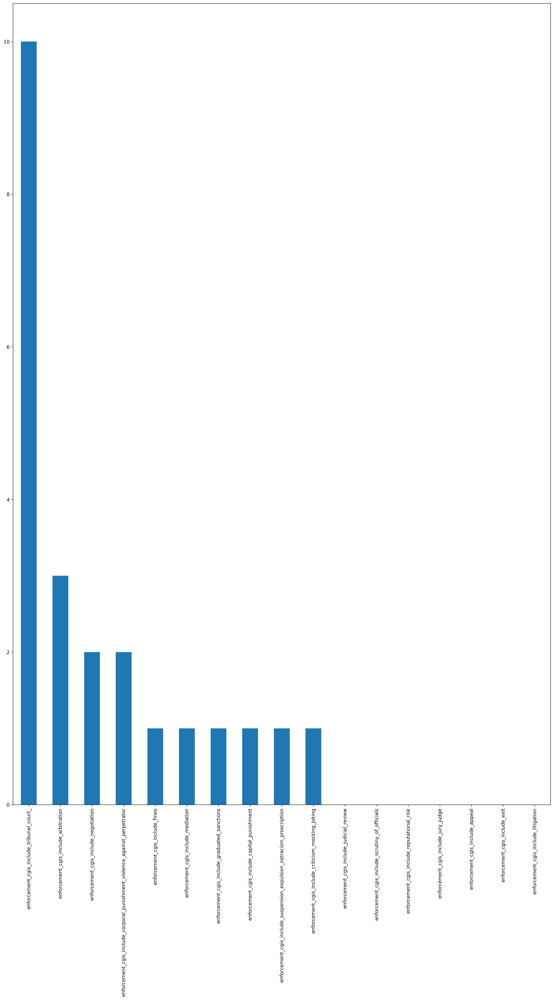

In [25]:
cgi_mechanisms_df[enforcement_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

# CGI Mechanism Analysis 

In [26]:
# Select columns of interest

In [27]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'SCCS',
 'is_SCCS',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'enforcement_mechanisms_include_capital_punishment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_council_central_',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_monitoring',
 'decision_making_mechanisms_include_bureaucracy',
 'enforcement_mechanisms_include_fines',
 'decision_making_mechanisms_include_plurality_voting',
 'enforcement_mechanisms_include_criticism_mocking_joking',
 'access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_co-optation',
 'decision_making_mechanism

In [28]:
# Drop community mechanisms
mechanisms_list = [x for x in cgi_df.columns if x.startswith('mechanisms')]
mechanisms_list

[]

In [29]:
cgi_df.drop(columns=mechanisms_list, inplace=True)

In [30]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'SCCS',
 'is_SCCS',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'enforcement_mechanisms_include_capital_punishment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_council_central_',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_monitoring',
 'decision_making_mechanisms_include_bureaucracy',
 'enforcement_mechanisms_include_fines',
 'decision_making_mechanisms_include_plurality_voting',
 'enforcement_mechanisms_include_criticism_mocking_joking',
 'access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_co-optation',
 'decision_making_mechanism

## Normalized Correlation Matrix

In [31]:
data_plot = cgi_df.select_dtypes(include=[np.number])

In [32]:
data_plot.describe()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_council_local,access_mechanisms_include_enfranchisement,decision_making_mechanisms_

In [33]:
data_plot.head()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_council_local,access_mechanisms_include_enfranchisement,decision_making_mechanisms_

In [34]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

In [35]:
norm_corr.head()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_council_local,access_mechanisms_include_enfranchisement,decision_making_mechanisms_

# Visualize and Sort CGI Correlations

In [36]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_triangle_correlations.png')
plt.show()

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_67668/4008594290.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


In [37]:
cgis_list = [x for x in cgi_df.columns if 'cgis_' in x]
cgis_list

['enforcement_cgis_include_jury_judge',
 'access_cgis_include_election',
 'enforcement_cgis_include_tribunal_court_',
 'decision_making_cgis_include_temporary_position_of_power_term_limits',
 'enforcement_cgis_include_arbitration',
 'access_cgis_include_matrilineality',
 'access_cgis_include_age_boundaries',
 'decision_making_cgis_include_magistrate_official',
 'decision_making_cgis_include_deliberation',
 'decision_making_cgis_include_consensus',
 'enforcement_cgis_include_mediation',
 'enforcement_cgis_include_graduated_sanctions',
 'enforcement_cgis_include_capital_punishment',
 'access_cgis_include_co-optation',
 'decision_making_cgis_include_consultation',
 'access_cgis_include_heredity',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'decision_making_cgis_include_consent',
 'decision_making_cgis_include_oath',
 'access_cgis_include_popularity_',
 'decision_making_cgis_include_quorum',
 'access_cgis_include_property_requirement',
 'decision_making_cgis_i

In [38]:
cgis_df = norm_corr[cgis_list]

In [39]:
cgis_df

,enforcement_cgis_include_jury_judge,access_cgis_include_election,enforcement_cgis_include_tribunal_court_,decision_making_cgis_include_temporary_position_of_power_term_limits,enforcement_cgis_include_arbitration,access_cgis_include_matrilineality,access_cgis_include_age_boundaries,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_deliberation,decision_making_cgis_include_consensus,enforcement_cgis_include_mediation,enforcement_cgis_include_graduated_sanctions,enforcement_cgis_include_capital_punishment,access_cgis_include_co-optation,decision_making_cgis_include_consultation,access_cgis_include_heredity,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_consent,decision_making_cgis_include_oath,access_cgis_include_popularity_,decision_making_cgis_include_quorum,access_cgis_include_property_requirement,decision_making_cgis_include_veto,access_cgis_include_screening_process,access_cgis_include_patronage_for_office,decision_making_cgis_include_plurality_voting,enforcement_cgis_include_criticism_mocking_joking,decision_making_cgis_include_public_meetings,enforcement_cgis_include_litigation,decision_making_cgis_include_frequent_and_or_regular_meetings,decision_making_cgis_include_remunerated_position,access_cgis_include_child_participation,enforcement_cgis_include_negotiation,decision_making_cgis_include_council_local,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_gathering,access_cgis_include_gerontocracy,decision_making_cgis_include_supermajority,enforcement_cgis_include_exit,decision_making_cgis_include_majority_voting,decision_making_cgis_include_group_voting,decision_making_cgis_include_vote_by_show_of_hands,access_cgis_include_matriarchy,decision_making_cgis_include_unanimity,decision_making_cgis_include_representation,decision_making_cgis_include_board_committee,enforcement_cgis_include_corporal_punishment_violence_against_perpetrator,access_cgis_include_payment_for_occupying_office,decision_making_cgis_include_assembly_central,access_cgis_include_lottery_random_selection,enforcement_cgis_include_appeal,decision_making_cgis_include_turnover_rotation,access_cgis_include_female_participation,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_assembly_elite,decision_making_cgis_include_delegation,decision_making_cgis_include_voting,decision_making_cgis_include_council_central_,access_cgis_include_meritocracy,enforcement_cgis_include_judicial_review,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_assembly_local,enforcement_cgis_include_reputational_risk,enforcement_cgis_include_scrutiny_of_officials,access_cgis_include_blood_relations,enforcement_cgis_include_fines,access_cgis_include_life_appointment
Time span: Start,-0.153110,-0.150145,-0.071682,-0.161821,0.050372,0.013983,-0.260173,-0.137627,0.011834,-0.002209,0.028170,0.030205,0.028731,0.037281,-0.050355,0.040160,-0.072138,0.006365,-0.090633,0.028386,-0.084144,-0.119130,0.041104,-0.149898,0.028170,0.029881,0.042763,-0.083399,-0.090633,-0.085781,-0.153651,0.059677,0.040015,0.124056,-0.105225,-0.117258,0.061780,0.085997,0.031244,0.022207,-0.134928,-0.084054,-0.117258,-0.091108,0.040055,0.028837,-0.114843,0.036359,0.016790,-0.234683,-0.192120,0.021561,-0.170415,0.044114,0.037898,-0.045696,-0.098638,-0.084565,-0.173417,0.082244,-0.083256,-0.118393,0.023281,-0.021669,0.013983,-0.175458,0.039938,0.030205,0.048476
Time span: End,-0.151986,-0.102931,-0.048362,-0.153313,0.049675,0.029324,-0.226169,-0.103844,0.029032,0.008997,0.023064,0.021229,0.022593,0.034163,-0.022343,0.043079,-0.080958,0.033727,-0.095624,0.022886,-0.051167,-0.072441,0.031491,-0.115343,0.023064,0.021546,0.030055,-0.061462,-0.095624,-0.076842,-0.141047,0.043442,0.032517,0.114132,-0.057873,-0.099838,0.076885,0.060960,0.036863,0.026807,-0.125740,-0.050935,-0.099838,-0

In [40]:
query_cgis_df = cgis_df.transpose()

In [41]:
query_cgis_df.head()

,Time span: Start,Time span: End,is_SCCS,decision_making_mechanisms_include_frequent_and_or_regular_meetings,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_council_central_,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_bureaucracy,enforcement_mechanisms_include_fines,decision_making_mechanisms_include_plurality_voting,enforcement_mechanisms_include_criticism_mocking_joking,access_mechanisms_include_age_boundaries,access_mechanisms_include_popularity_,access_mechanisms_include_co-optation,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_autocratic_leader_chief_bound,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_destruction_of_property,access_mechanisms_include_heredity,access_mechanisms_include_matriarchy,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_petition,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_balance_of_power,enforcement_mechanisms_include_arbitration,access_mechanisms_include_screening_process,enforcement_mechanisms_include_self-help,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_delegation,access_mechanisms_include_dreaming,access_mechanisms_include_blood_relations,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_vote_by_show_of_hands,access_mechanisms_include_divine_right,decision_making_mechanisms_include_leader_first_among_equals,enforcement_mechanisms_include_scrutiny_of_officials,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,access_mechanisms_include_meritocracy,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_remunerated_position,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_turnover_rotation,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_voting,access_mechanisms_include_induction_rite_ceremony,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_council_local,access_mechanisms_include_enfranchisement,decision_making_mechanisms_

## Time x Region x Size for CGIs

In [42]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [43]:
region_cols = [r for r in list(cgi_df) if 'Region: ' in r] 

In [44]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [45]:
list(cgi_df.columns)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'SCCS',
 'is_SCCS',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'enforcement_mechanisms_include_capital_punishment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_council_central_',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_monitoring',
 'decision_making_mechanisms_include_bureaucracy',
 'enforcement_mechanisms_include_fines',
 'decision_making_mechanisms_include_plurality_voting',
 'enforcement_mechanisms_include_criticism_mocking_joking',
 'access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_co-optation',
 'decision_making_mechanism

## Time x CGIs

In [46]:
time_cgis = query_cgis_df[time_span_cols]
time_cgis

,Time span: Start,Time span: End,Time span: Duration
enforcement_cgis_include_jury_judge,-0.153110,-0.151986,0.069942
access_cgis_include_election,-0.150145,-0.102931,0.188612
enforcement_cgis_include_tribunal_court_,-0.071682,-0.048362,0.092074
decision_making_cgis_include_temporary_position_of_power_term_limits,-0.161821,-0.153313,0.092973
enforcement_cgis_include_arbitration,0.050372,0.049675,-0.023860
access_cgis_include_matrilineality,0.013983,0.029324,0.033812
access_cgis_include_age_boundaries,-0.260173,-0.226169,0.202386
decision_making_cgis_include_magistrate_official,-0.137627,-0.103844,0.148173
decision_making_cgis_include_deliberation,0.011834,0.029032,0.039587
decision_making_cgis_include_consensus,-0.002209,0.008997,0.030134


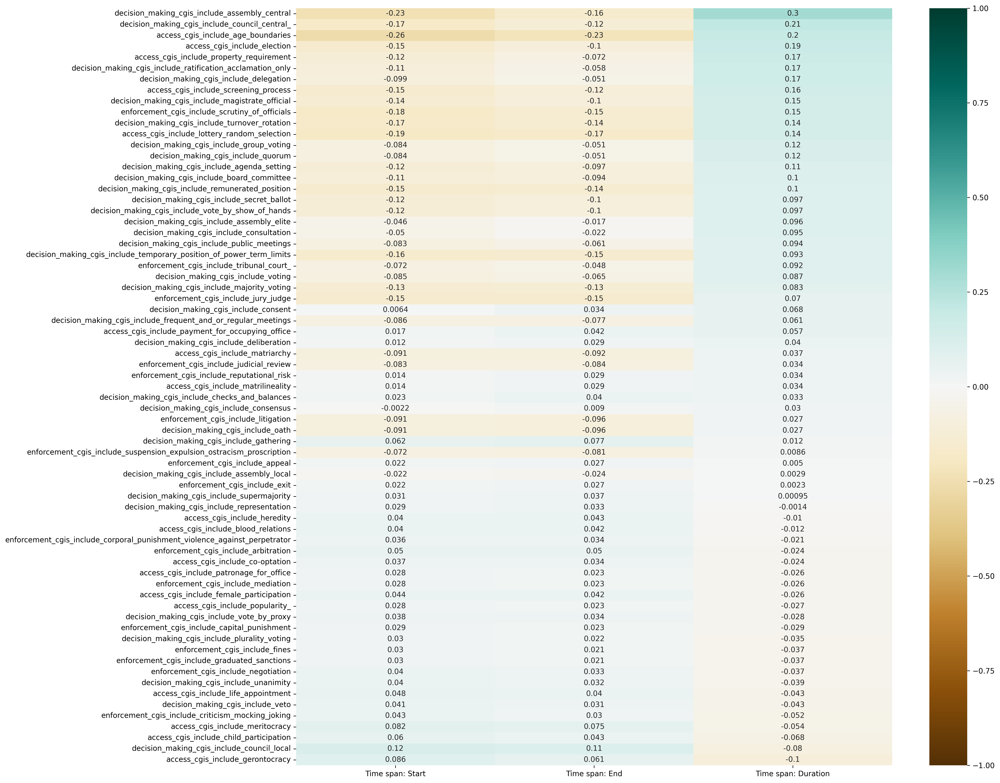

In [47]:
plt.figure(figsize=(20,15))

sns.heatmap(time_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_time.png')
plt.show()

### Time x CGIs: Access, Decision Making, Enforcement

In [48]:
access_cgis

['access_cgis_include_election',
 'access_cgis_include_matrilineality',
 'access_cgis_include_age_boundaries',
 'access_cgis_include_co-optation',
 'access_cgis_include_heredity',
 'access_cgis_include_popularity_',
 'access_cgis_include_property_requirement',
 'access_cgis_include_screening_process',
 'access_cgis_include_patronage_for_office',
 'access_cgis_include_child_participation',
 'access_cgis_include_gerontocracy',
 'access_cgis_include_matriarchy',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_lottery_random_selection',
 'access_cgis_include_female_participation',
 'access_cgis_include_meritocracy',
 'access_cgis_include_blood_relations',
 'access_cgis_include_life_appointment']

In [49]:
time_access_cgis = time_cgis.loc[access_cgis]

In [50]:
time_access_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_election,-0.150145,-0.102931,0.188612
access_cgis_include_matrilineality,0.013983,0.029324,0.033812
access_cgis_include_age_boundaries,-0.260173,-0.226169,0.202386
access_cgis_include_co-optation,0.037281,0.034163,-0.024432
access_cgis_include_heredity,0.040160,0.043079,-0.009979
access_cgis_include_popularity_,0.028386,0.022886,-0.026741
access_cgis_include_property_requirement,-0.119130,-0.072441,0.173670
access_cgis_include_screening_process,-0.149898,-0.115343,0.155553
access_cgis_include_patronage_for_office,0.028170,0.023064,-0.025621
access_cgis_include_child_participation,0.059677,0.043442,-0.068379


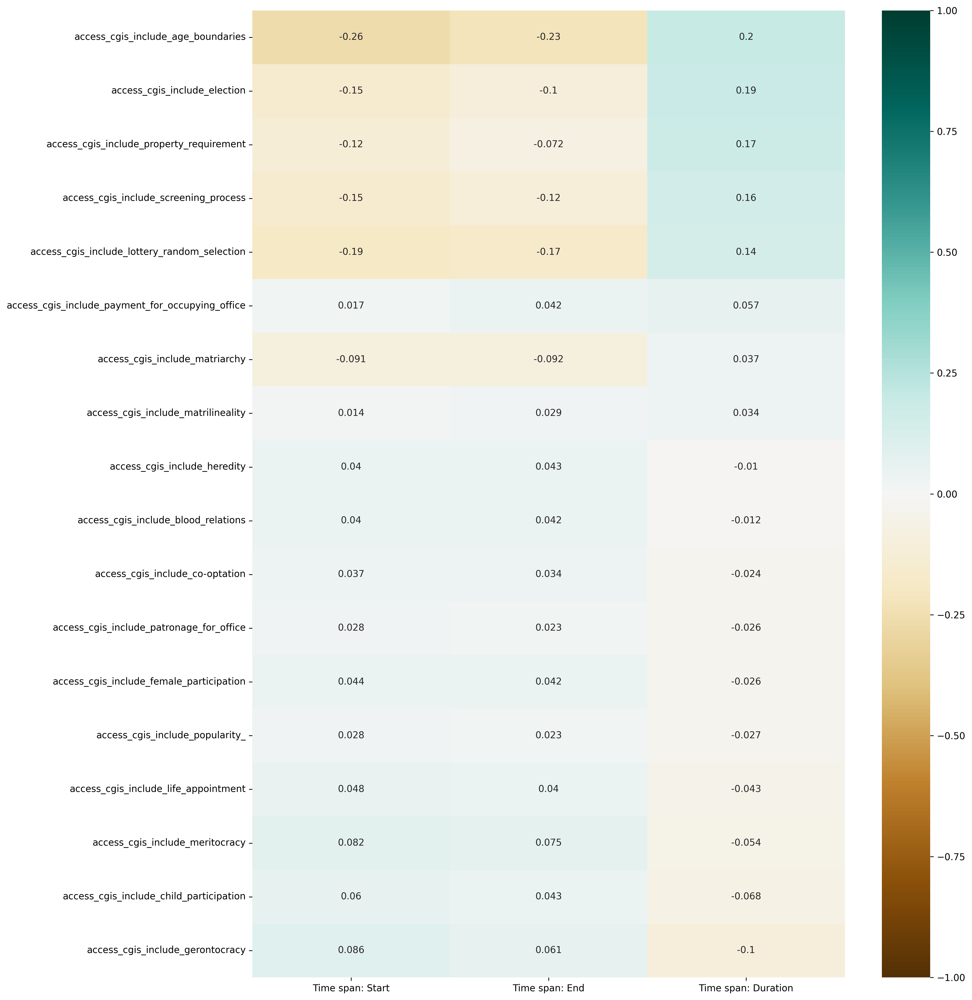

In [51]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_access_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_access_cgis.png')
plt.show()

In [52]:
time_decision_making_cgis = time_cgis.loc[decision_making_cgis]

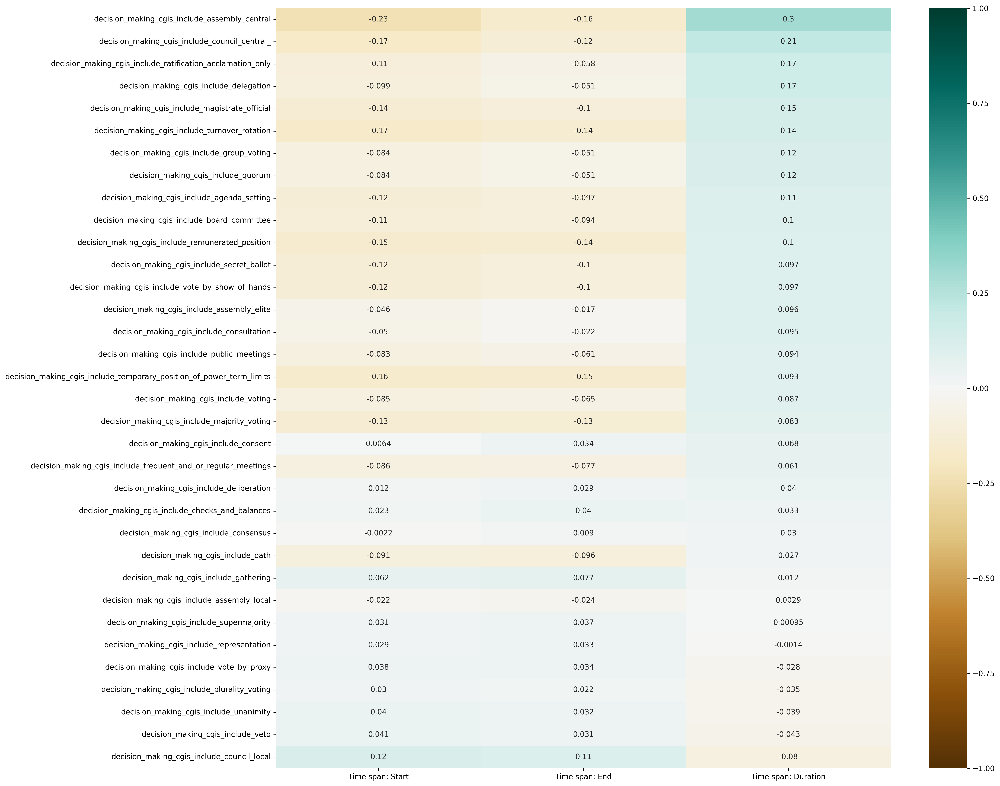

In [53]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_decision_making_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_decision_making_cgis.png')
plt.show()

In [54]:
time_enforcement_cgis = time_cgis.loc[enforcement_cgis]

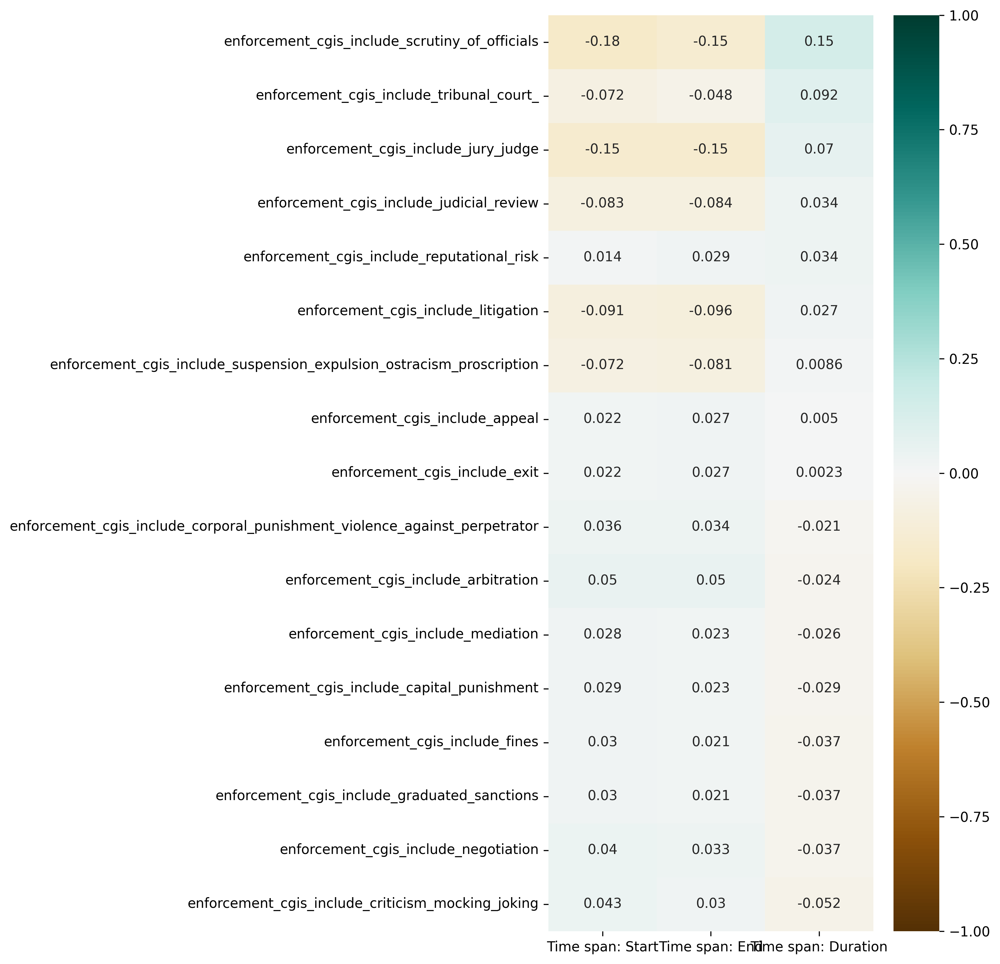

In [55]:
plt.figure(figsize=(10,10))

sns.heatmap(time_enforcement_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_enforcement_cgis.png')
plt.show()

## Region x CGIs

In [56]:
region_cgis = query_cgis_df[region_cols]
region_cgis

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
enforcement_cgis_include_jury_judge,0.028436,-0.032395,-0.036346,0.068237,-0.042112,-0.015560,-0.011323,-0.018468
access_cgis_include_election,0.126851,0.208146,-0.024470,-0.054235,-0.057514,0.001073,-0.026543,-0.043292
enforcement_cgis_include_tribunal_court_,-0.050283,0.156965,-0.028865,-0.018705,-0.083279,-0.002275,-0.032928,0.003230
decision_making_cgis_include_temporary_position_of_power_term_limits,-0.040303,0.284503,-0.050599,-0.032209,-0.058625,-0.021661,-0.015763,-0.025710
enforcement_cgis_include_arbitration,-0.033756,-0.037772,0.049140,-0.026976,-0.049101,-0.018142,-0.013203,0.211984
access_cgis_include_matrilineality,0.084027,-0.018857,-0.021157,-0.013467,-0.024512,-0.009057,-0.006591,-0.010750
access_cgis_include_age_boundaries,-0.048120,0.412593,-0.067023,-0.042663,-0.077654,-0.028692,0.003976,-0.034055
decision_making_cgis_include_magistrate_official,-0.021605,0.232607,-0.042757,-0.027217,-0.049539,-0.018304,-0.013320,-0.021725
decision_making_cgis_include_deliberation,-0.033157,0.060072,-0.068948,-0.055011,0.080854,0.036505,-0.038978,0.065908
decision_making_cgis_include_consensus,-0.052385,0.077035,-0.012951,-0.062173,0.053361,0.033784,0.008636,0.065846


In [57]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_cgis = region_cgis[cols_to_move + [col for col in region_cgis.columns if col not in cols_to_move ]]

In [58]:
plt.figure(figsize=(20,15))

sns.heatmap(region_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_region.png')
plt.show()

### Region x CGIs: Access, Decision Making, Enforcement

In [59]:
region_access_cgis = region_cgis.loc[access_cgis]

In [60]:
plt.figure(figsize=(10,10))

sns.heatmap(region_access_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_access_cgis.png')
plt.show()

In [61]:
region_decision_making_cgis = region_cgis.loc[decision_making_cgis]

In [62]:
plt.figure(figsize=(20,15))

sns.heatmap(region_decision_making_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_decision_making_cgis.png')
plt.show()

In [63]:
region_enforcement_cgis = region_cgis.loc[enforcement_cgis]

In [ ]:
plt.figure(figsize=(10,8))

sns.heatmap(region_enforcement_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_enforcement_cgis.png')
plt.show()

## Size x CGIs

In [65]:
size_cgis = query_cgis_df[size_cols]

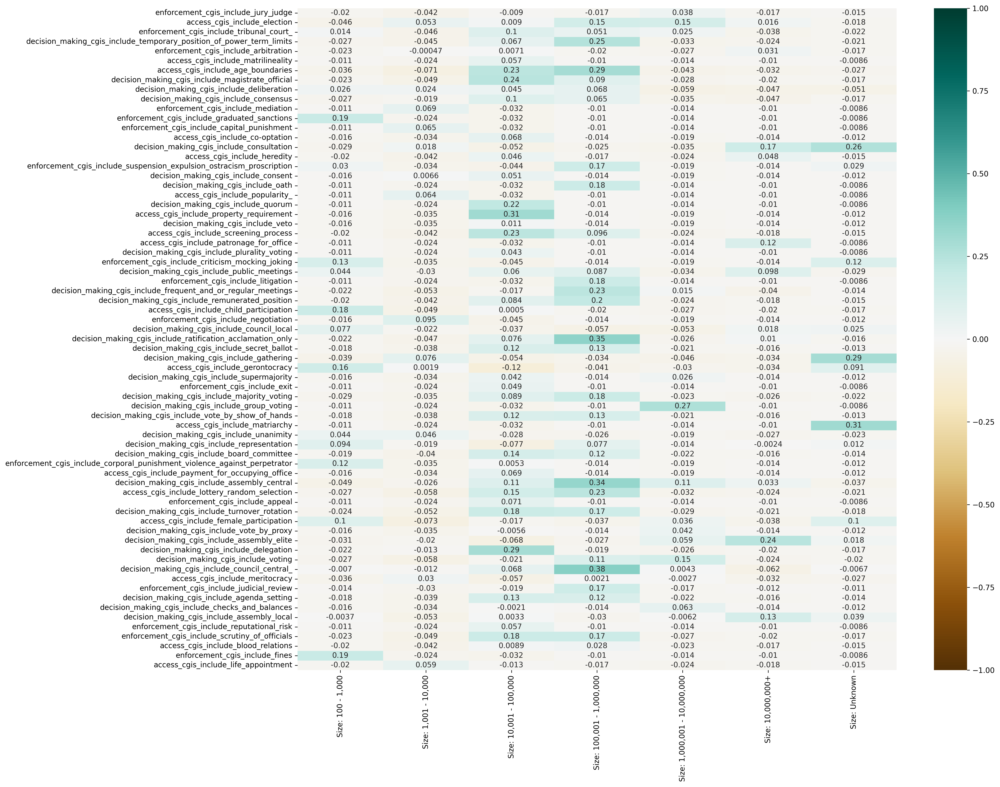

In [66]:
plt.figure(figsize=(20,15))

sns.heatmap(size_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_size.png')
plt.show()

### Size x CGIs: Access, Decision Making, Enforcement

In [67]:
size_access_cgis = size_cgis.loc[access_cgis]

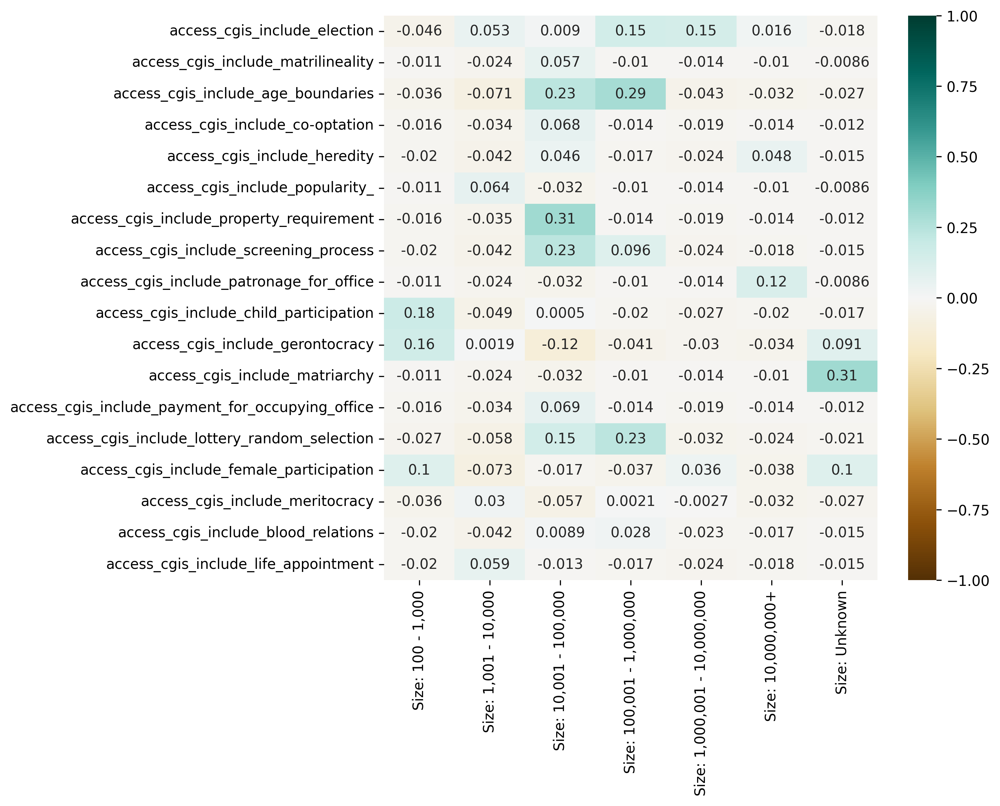

In [68]:
plt.figure(figsize=(10,8))

sns.heatmap(size_access_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_access_cgis.png')
plt.show()

In [69]:
size_decision_making_cgis = size_cgis.loc[decision_making_cgis]

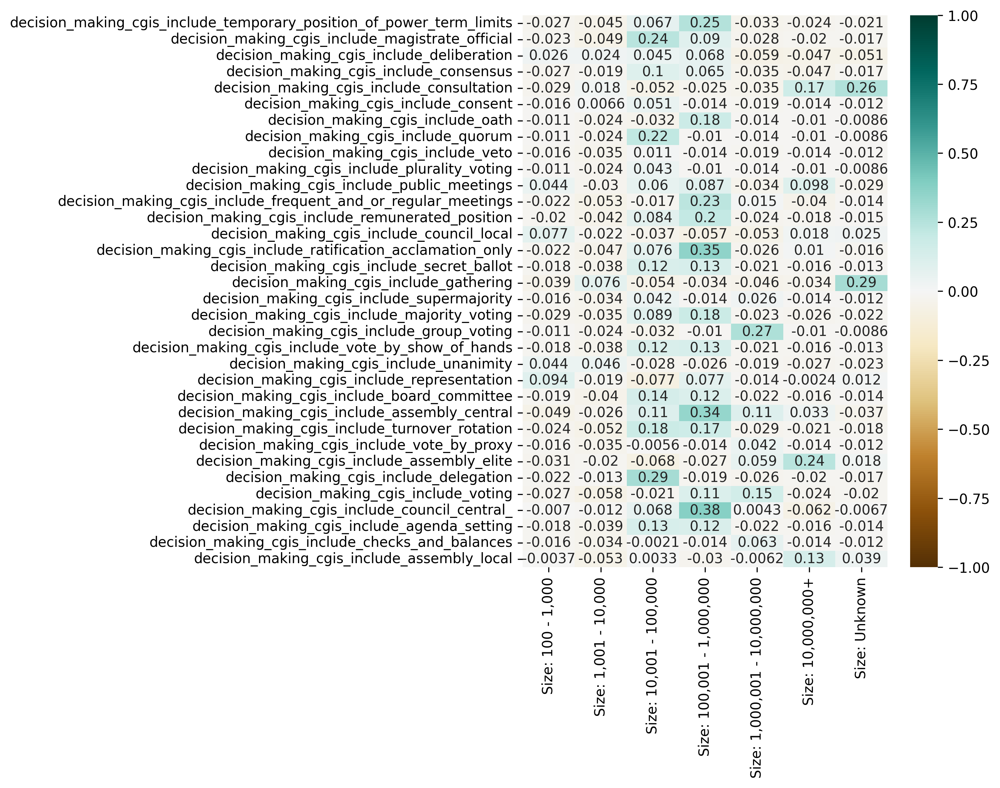

In [70]:
plt.figure(figsize=(10,8))

sns.heatmap(size_decision_making_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_decision_making_cgis.png')
plt.show()

In [71]:
size_enforcement_cgis = size_cgis.loc[enforcement_cgis]

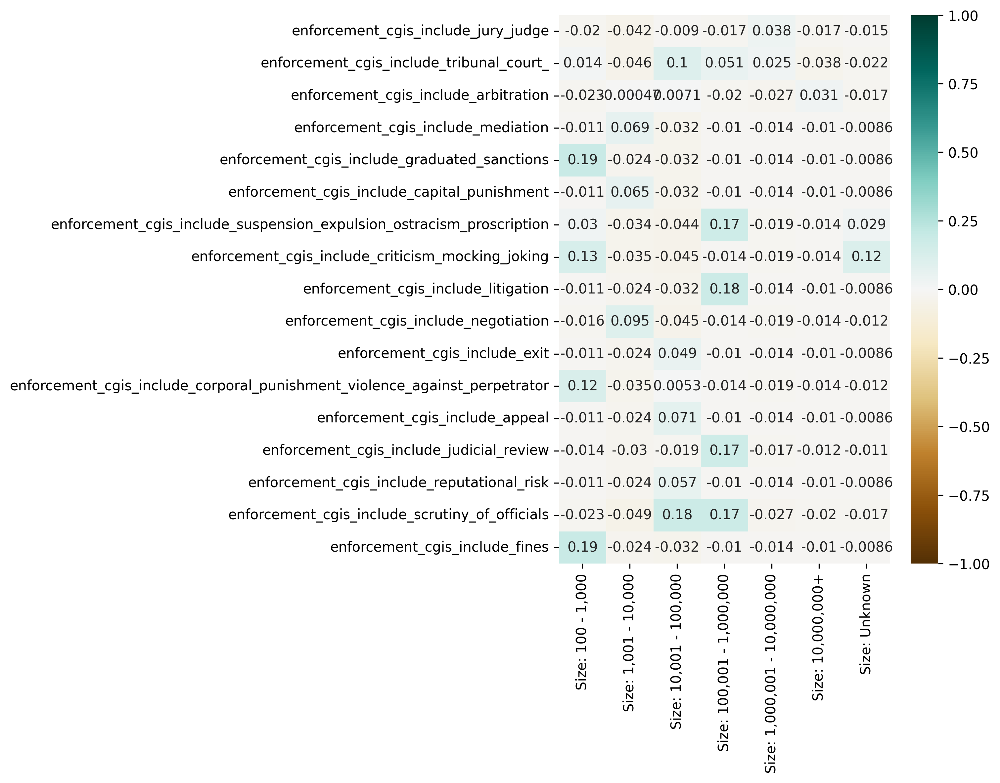

In [72]:
plt.figure(figsize=(10,8))

sns.heatmap(size_enforcement_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_enforcement_cgis.png')
plt.show()

# Sorted positive and negative correlations

In [73]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [74]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [75]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

decision_making_mechanisms_include_petition        Geography: Africa North                                   1.000000
decision_making_cgis_include_oath                  enforcement_cgis_include_litigation                       1.000000
access_cgis_include_matrilineality                 enforcement_cgis_include_reputational_risk                1.000000
enforcement_mechanisms_include_civil_disobedience  Geography: North America, Louisiana                       1.000000
decision_making_mechanisms_include_mandate         Geography: Middle East, Mesopotamia, Babylonia            1.000000
                                                                                                               ...   
Time span: Start                                   decision_making_mechanisms_include_magistrate_official   -0.495251
Time span: End                                     Geography: Middle East                                   -0.533564
                                                   Regio

In [76]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/' + DATA_VERSION + '/SCCS/cgis_all_correlations.csv')

In [77]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: Start                                          decision_making_mechanisms_include_assembly_central      -0.584785
                                                          Time span: Duration                                      -0.570624
Time span: End                                            Region: Middle East                                      -0.560424
                                                          Geography: Middle East                                   -0.533564
Time span: Start                                          decision_making_mechanisms_include_magistrate_official   -0.495251
                                                                                                                      ...   
access_cgis_include_matrilineality                        enforcement_cgis_include_reputational_risk                1.000000
decision_making_mechanisms_include_lobbying               Geography: Africa West, Mid-western Nigeria               1.000000


In [78]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/' + DATA_VERSION + '/SCCS/cgis_negative_correlations.csv')